#cattle Image Disease Processing
#Detection and Classification of Cattle Diseases by Deep Learing
# Aim: To detect and classify 3 major types of Cattle Diseases by Image processing technique.
# Methedology:
#Importing the required Packages
#Data Preprocessing
#Data Augumentation
#Model Building(VGG16)
#Validation
#Passing the test set and looking for accuracy.

In [1]:
!pip install opencv-python==4.5.5.62
!pip install opencv-contrib-python==4.5.5.62
!pip install tf-explain
!pip install keras_applications
!pip install keras-squeezenet
!pip install tensorflow
!pip install --upgrade tensorflow

Reason for being yanked: deprecated, use 4.5.5.64
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.4/60.4 MB 12.3 MB/s eta 0:00:00
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.10.0.84
    Uninstalling opencv-python-4.10.0.84:
      Successfully uninstalled opencv-python-4.10.0.84
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.6/66.6 MB 10.0 MB/s eta 0:00:00
  Attempting uninstall: opencv-contrib-python
    Found existing installation: opencv-contrib-python 4.10.0.84
    Uninstalling opencv-contrib-python-4.10.0.84:
      Successfully uninstalled opencv-contrib-python-4.10.0.84
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 2.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for keras-squeezenet: filename=keras_squeezenet-0.4-py3-none-any.whl size=3573 sha256=853afbe14c389ab4d1abe29ef7de3ac7f858fe1fe71b4eeab7fef59302f1539b
  Stored in 

In [22]:
import tensorflow as tf
from tensorflow import keras
from keras import Sequential
from keras.layers import Dense,Flatten
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
import os


In [53]:
# Basic Packages
import keras
from skimage import io
import os
from glob import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import random
import warnings
warnings.simplefilter("ignore")
import cv2
from PIL import Image
from tqdm import tqdm
import random as rnd
from numpy import expand_dims


In [4]:

# Packages for preprocessing and augumentation
from skimage.transform import rescale
from tensorflow import keras
from tensorflow.keras import datasets, models, layers, optimizers
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from google.colab.patches import cv2_imshow



In [5]:
import os
import gc
import sys

import pandas as pd
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import skimage
from skimage.feature import hog, canny
from skimage.filters import sobel
from skimage import color

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder




In [6]:
# Install necessary packages
!pip install tensorflow keras tf-explain

# Import necessary libraries
from tensorflow.keras import layers
import tensorflow.keras.backend as K
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.preprocessing import image
from tensorflow.keras.layers import (
    Input, Dense, Activation, Dropout, Flatten, BatchNormalization,
    Conv2D, MaxPooling2D, AveragePooling2D, GlobalAveragePooling2D
)
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.utils import get_file

from sklearn.model_selection import train_test_split
from tf_explain.core.grad_cam import GradCAM



In [62]:
train_main_path = '/content/drive/MyDrive/cow _disease/train'
path_train_FMD = os.path.join(train_main_path, 'FMD')
path_train_IBK = os.path.join(train_main_path, 'IBK')
path_train_LSD = os.path.join(train_main_path, 'LSD')
path_train_NOR = os.path.join(train_main_path, 'NOR')



In [63]:
dirs = [path_train_FMD, path_train_IBK, path_train_LSD, path_train_NOR]

classes = []
paths = []

for image_dir in dirs:
    class_name = os.path.basename(image_dir)  # Extract the last part of the directory path
    for image in os.listdir(image_dir):
        classes.append(class_name)
        paths.append(os.path.join(image_dir, image))

In [64]:
# Create DataFrame
train_df = pd.DataFrame({
    'classname': classes,
    'path': paths
})

In [65]:
train_df.tail(100)

,classname,path
842,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...
843,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...
844,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...
845,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...
846,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...
...,...,...
937,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...
938,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...
939,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...
940,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...


In [11]:
classes = {'FMD': 'Foot-and-mouth disease',
'IBK': 'Infectious Bovine Keratoconjunctivitis',
'LSD': ' lysergic acid diethylamide',
'NOR':'Normal Cow'}

In [12]:
train_df.count()

,0
classname,942
path,942


In [13]:
print('Train samples count: ', len(train_df))
train_df.columns

Train samples count:  942


Index(['classname', 'path'], dtype='object')

In [14]:
print('Class Count: ',len(train_df['classname'].value_counts()))
train_df['classname'].unique()

Class Count:  4


array(['FMD', 'IBK', 'LSD', 'NOR'], dtype=object)

**Checking missing data**

Lets check if there is any missing values in our dataset

In [15]:
train_df.isnull().sum()

,0
classname,0
path,0


**Visualization**

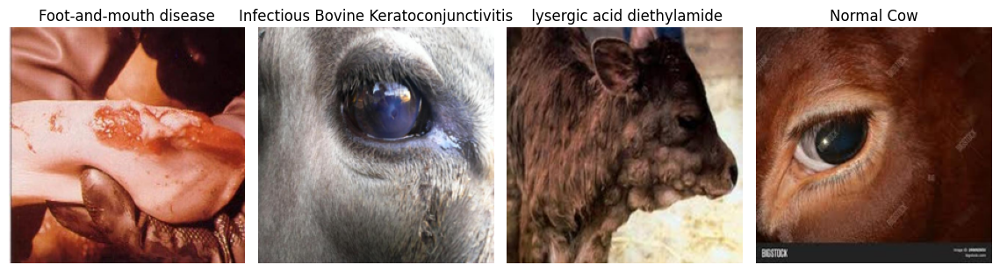

In [16]:
plt.figure(figsize = (20,18))
for idx,i in enumerate(train_df.classname.unique()):
    plt.subplot(4,7,idx+1)
    df = train_df[train_df['classname'] ==i].reset_index(drop = True)
    image_path = df.loc[rnd.randint(0, len(df))-1,'path']
    img = Image.open(image_path)
    img = img.resize((224,224))
    plt.imshow(img)
    plt.axis('off')
    plt.title(classes[i])
plt.tight_layout()
plt.show()

In [17]:
def plot_species(df,class_name):
    plt.figure(figsize = (20,18))
    classes_df = train_df[train_df['classname'] ==  class_name].reset_index(drop = True)
    plt.suptitle(classes[class_name])
    for idx,i in enumerate(np.random.choice(classes_df['path'],32)):
        plt.subplot(8,8,idx+1)
        image_path = i
        img = Image.open(image_path)
        img = img.resize((224,224))
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

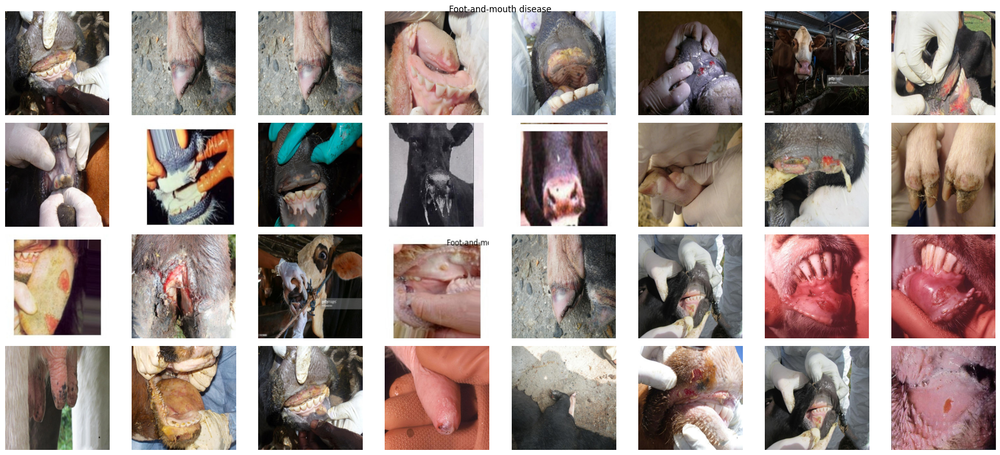

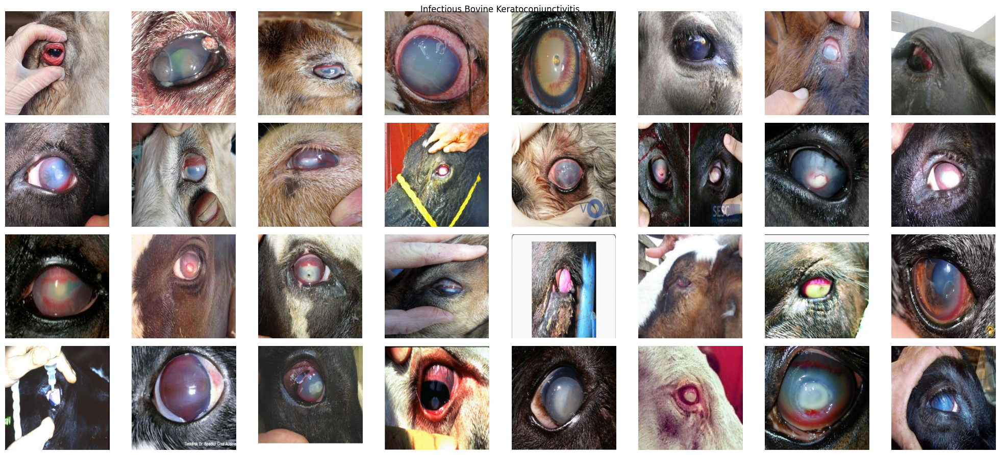

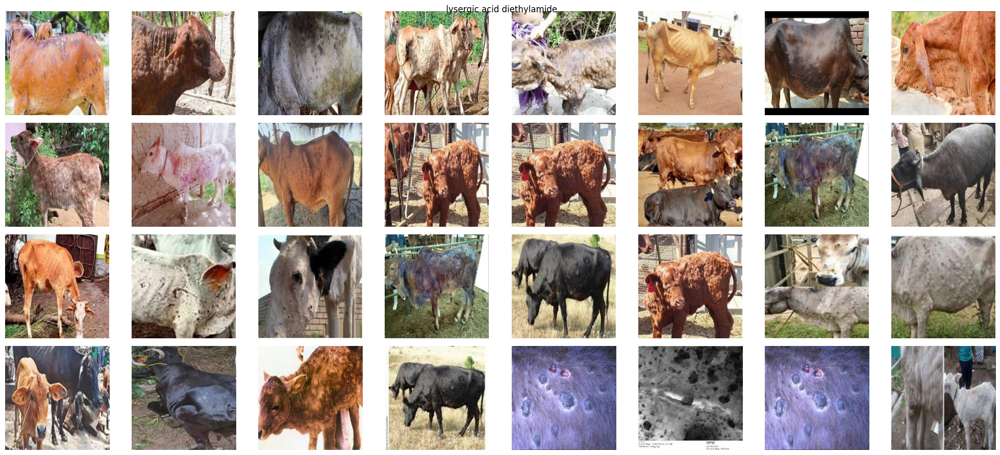

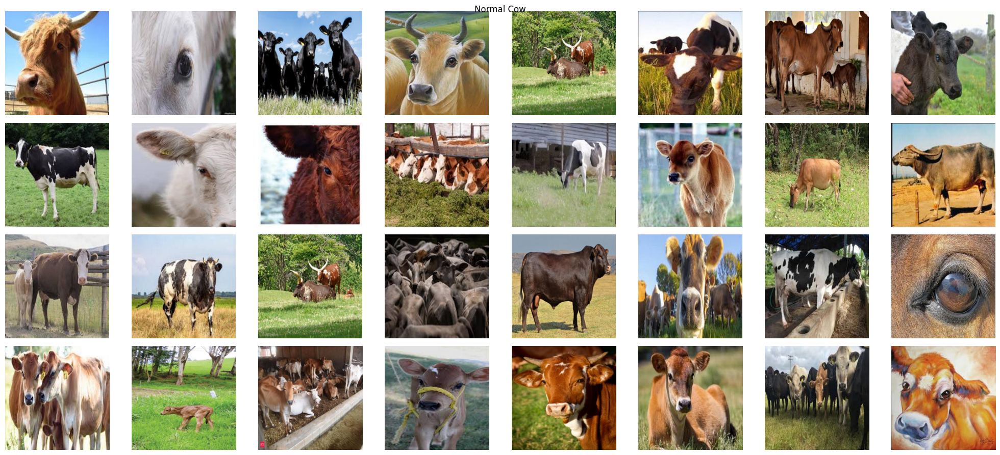

In [18]:
for class_ in train_df['classname'].unique():
    #print('\n\n')
    plot_species(train_df , class_)

**Class Distribution Analysis**

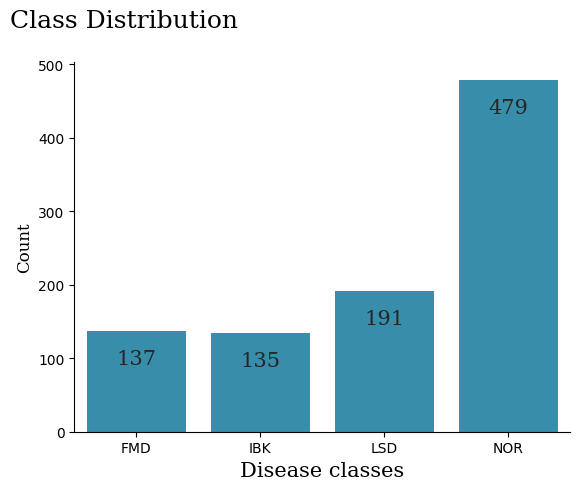

In [19]:
plot = sns.countplot(x = train_df['classname'], color = '#2596be')
sns.set(rc={'figure.figsize':(30,25)})
sns.despine()
plot.set_title('Class Distribution\n', font = 'serif', x = 0.1, y=1, fontsize = 18);
plot.set_ylabel("Count", x = 0.02, font = 'serif', fontsize = 12)
plot.set_xlabel("Disease classes", fontsize = 15, font = 'serif')

for p in plot.patches:
    plot.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2, p.get_height()),
       ha = 'center', va = 'center', xytext = (0, -20),font = 'serif', textcoords = 'offset points', size = 15)


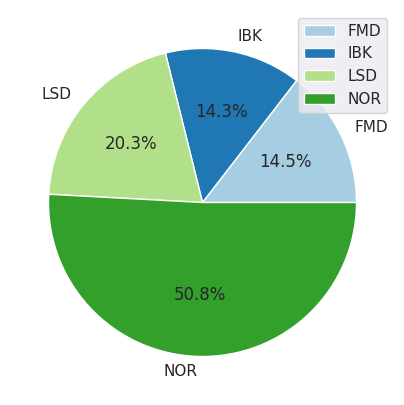

In [20]:
plt.figure(figsize=(5,5))
class_cnt = train_df.groupby(['classname']).size().reset_index(name = 'counts')
colors = sns.color_palette('Paired')[0:9]
plt.pie(class_cnt['counts'], labels=class_cnt['classname'], colors=colors, autopct='%1.1f%%')
plt.legend(loc='upper right')
plt.show()

**Checking the Resolution of the Image **

In [21]:
widths, heights = [], []

for path in tqdm(train_df["path"]):
    width, height = Image.open(path).size
    widths.append(width)
    heights.append(height)

train_df["width"] = widths
train_df["height"] = heights
train_df["dimension"] = train_df["width"] * train_df["height"]

100%|██████████| 942/942 [08:17<00:00,  1.89it/s]


**Look at the small images data **

In [ ]:
train_df.sort_values('width').head(84)

,classname,path,width,height,dimension
0,FMD,/content/drive/MyDrive/cow _disease/train/FMD/...,640,640,409600
620,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...,640,640,409600
621,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...,640,640,409600
622,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...,640,640,409600
623,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...,640,640,409600
...,...,...,...,...,...
699,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...,640,640,409600
700,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...,640,640,409600
701,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...,640,640,409600
702,NOR,/content/drive/MyDrive/cow _disease/train/NOR/...,640,640,409600


**Color Analysis**

In [ ]:
def is_grey_scale(givenImage):
    w,h = givenImage.size
    for i in range(w):
        for j in range(h):
            r,g,b = givenImage.getpixel((i,j))
            if r != g != b: return False
    return True

In [ ]:
sampleFrac = 0.5
#get our sampled images
isGreyList = []
for imageName in train_df['path'].sample(frac=sampleFrac):
    val = Image.open(imageName).convert('RGB')
    isGreyList.append(is_grey_scale(val))
print(np.sum(isGreyList) / len(isGreyList))
del isGreyList

0.004246284501061571


In [ ]:
def get_rgb_men(row):
    img = cv2.imread(row['path'])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return np.sum(img[:,:,0]), np.sum(img[:,:,1]), np.sum(img[:,:,2])

tqdm.pandas()
train_df['R'], train_df['G'], train_df['B'] = zip(*train_df.progress_apply(lambda row: get_rgb_men(row), axis=1))

100%|██████████| 942/942 [00:17<00:00, 52.65it/s]


In [ ]:
def show_color_dist(df, count):
    fig, axr = plt.subplots(count,2,figsize=(15,15))
    if df.empty:
        print("Image internsity of selected color is weak")
        return
    for idx, i in enumerate(np.random.choice(df['path'], count)):
        img = cv2.imread(i)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        axr[idx,0].imshow(img)
        axr[idx,0].axis('off')
        axr[idx,1].set_title('R={:.0f}, G={:.0f}, B={:.0f} '.format(np.mean(img[:,:,0]), np.mean(img[:,:,1]), np.mean(img[:,:,2])))
        x, y = np.histogram(img[:,:,0], bins=255)
        axr[idx,1].bar(y[:-1], x, label='R', alpha=0.8, color='red')
        x, y = np.histogram(img[:,:,1], bins=255)
        axr[idx,1].bar(y[:-1], x, label='G', alpha=0.8, color='green')
        x, y = np.histogram(img[:,:,2], bins=255)
        axr[idx,1].bar(y[:-1], x, label='B', alpha=0.8, color='blue')
        axr[idx,1].legend()
        axr[idx,1].axis('off')

**Red images and their color distribution **


Since we are picking random images, some image may appear multiple times

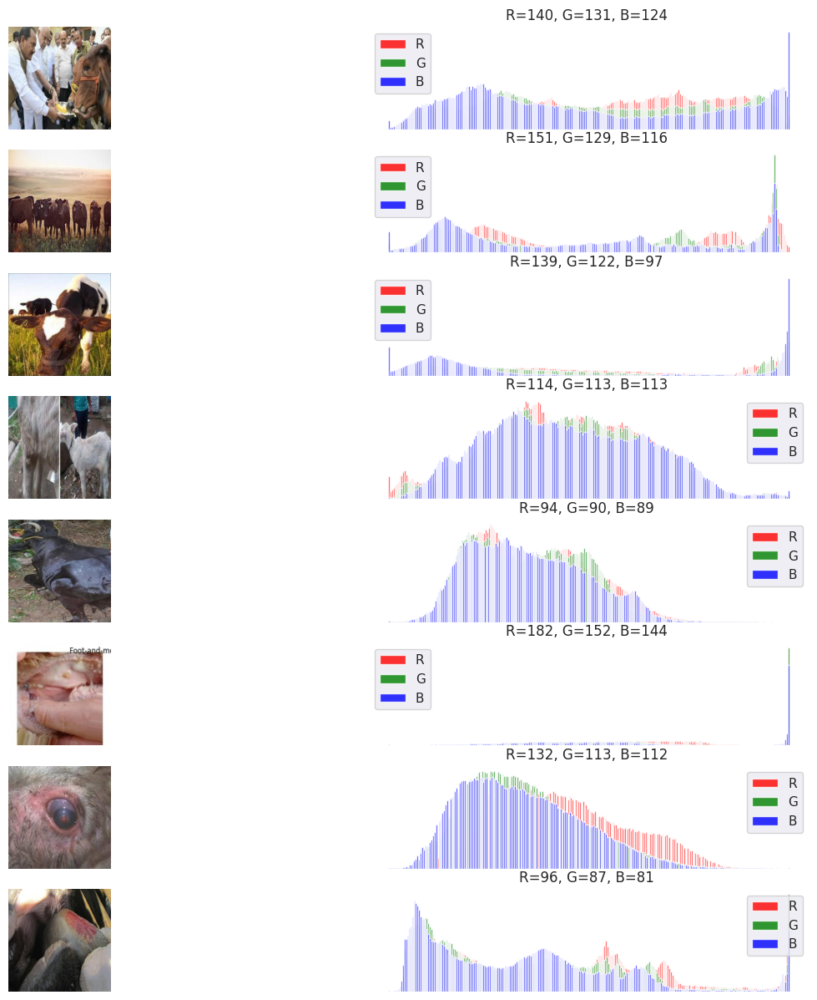

In [ ]:
df = train_df[((train_df['B']) < train_df['R']) & ((train_df['G']) < train_df['R'])]
if df.size != 0:
    show_color_dist(df, 8)

**Green images and their color distribution**


Since we are picking random images, some image may appear multiple times

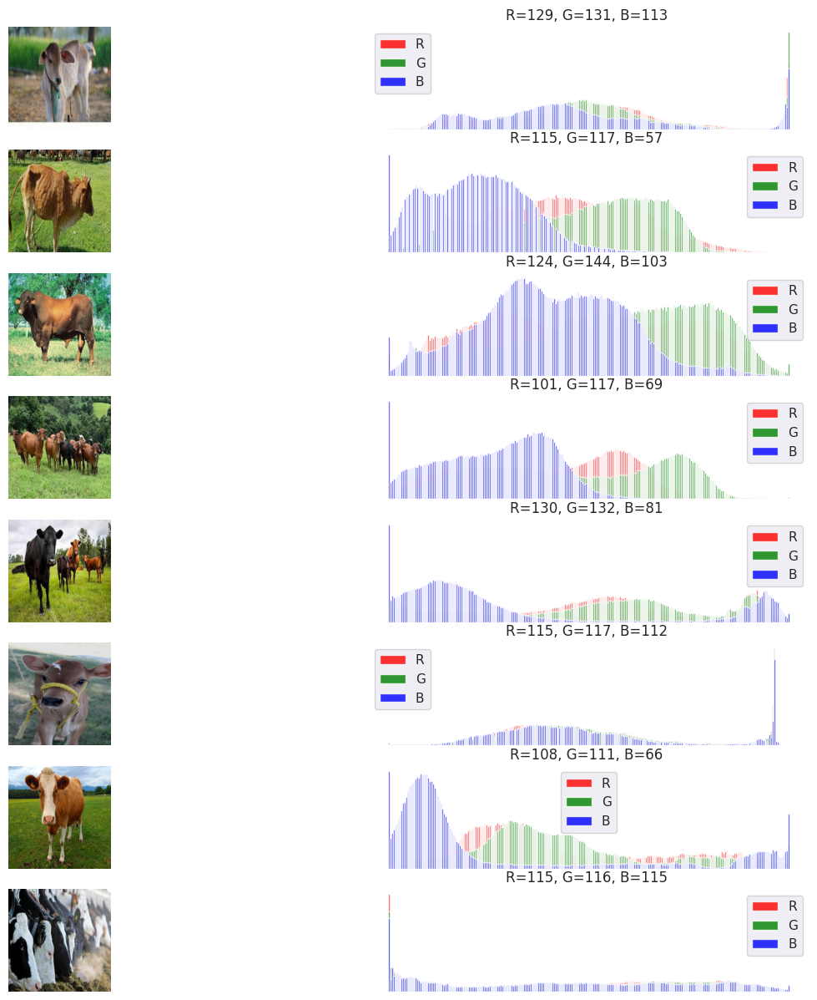

In [ ]:
df = train_df[(train_df['G'] > train_df['R']) & (train_df['G'] > train_df['B'])]
if df.size != 0:
    show_color_dist(df, 8)

**Blue images and their color distribution**

Since we are picking random images, some image may appear multiple times

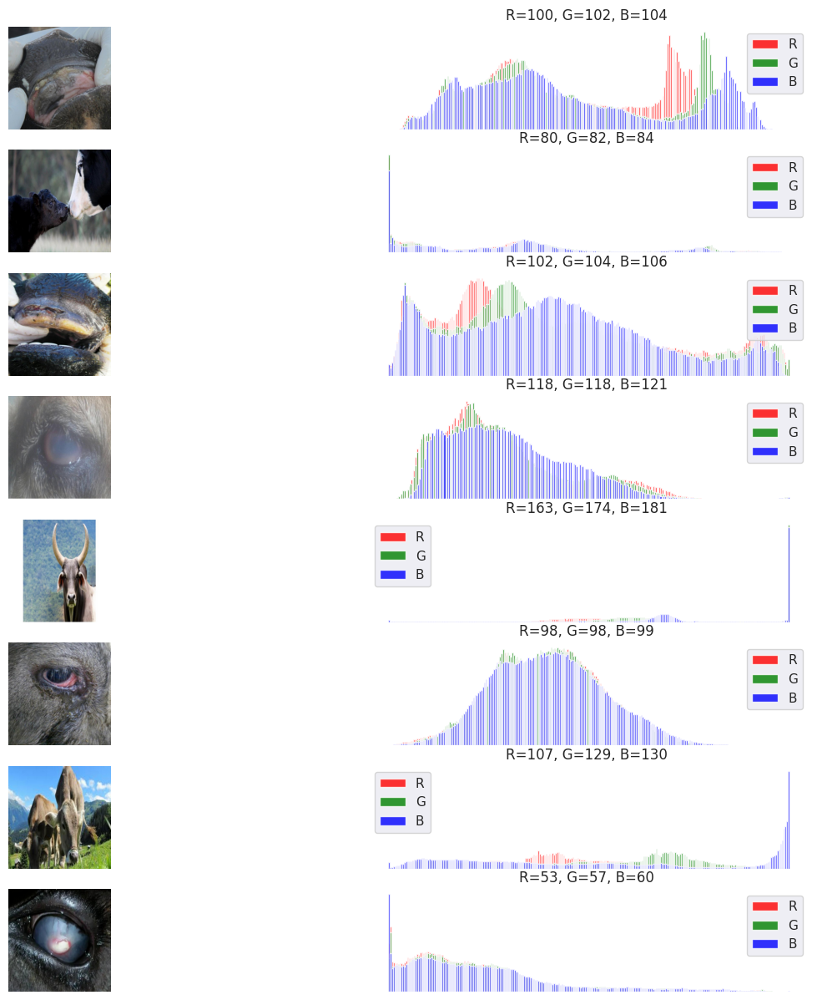

In [ ]:
df = train_df[(train_df['B'] > train_df['R']) & (train_df['B'] > train_df['G'])]
if df.size != 0:
    show_color_dist(df, 8)

**Fatures **

**Analyzing Edge**


### A Sobel filter is one means of getting a basic edge magnitude/gradient image. Can be useful to threshold and find prominent linear features, etc. Several other similar filters in skimage.filters are also good edge detectors: roberts, scharr, etc. and you can control direction, i.e. use an anisotropic version.

In [ ]:
def edges_images_gray(class_name):
    classes_df = train_df[train_df['classname'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_df['path'],2)):
        image = cv2.imread(i)
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        edges = sobel(image)
        gray_edges=sobel(gray)
        dimension = edges.shape
        fig = plt.figure(figsize=(8, 8))
        plt.suptitle(classes[class_name])
        plt.subplot(2,2,1)
        plt.imshow(gray_edges)
        plt.subplot(2,2,2)
        plt.imshow(edges[:dimension[0],:dimension[1],0], cmap="gray")
        plt.subplot(2,2,3)
        plt.imshow(edges[:dimension[0],:dimension[1],1], cmap='gray')
        plt.subplot(2,2,4)
        plt.imshow(edges[:dimension[0],:dimension[1],2], cmap='gray')
        plt.show()


In [ ]:
for class_name in train_df['classname'].unique():
    edges_images_gray(class_name)

**HSV Transform **

Since this contest is about time series ordering, I think it's possible there may be useful information in a transform to HSV color space. HSV is useful for identifying shadows and illumination, as well as giving us a means to identify similar objects that are distinct by color between scenes (hue), though there's no guarantee the hue will be stable.

In [ ]:
def hsv_images(class_name):
    classes_df = train_df[train_df['classname'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(train_df['path'],2)):
        image = cv2.imread(i)
        hsv = color.rgb2hsv(image)
        dimension = hsv.shape
        fig = plt.figure(figsize=(8, 8))
        plt.suptitle(classes[class_name])
        plt.subplot(2,2,1)
        plt.imshow(image)
        plt.subplot(2,2,2)
        plt.imshow(hsv[:dimension[0],:dimension[1],0], cmap="PuBuGn")
        plt.subplot(2,2,3)
        plt.imshow(hsv[:dimension[0],:dimension[1],1], cmap='PuBuGn')
        plt.subplot(2,2,4)
        plt.imshow(hsv[:dimension[0],:dimension[1],2], cmap='PuBuGn')
        plt.show()


In [ ]:
for class_name in train_df['classname'].unique():
    hsv_images(class_name)

**Corner **

In [ ]:
def corners_images_gray(class_name):
    classes_df = train_df[train_df['classname'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_df['path'],4)):
        image = cv2.imread(i)
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        corners_gray = cv2.goodFeaturesToTrack(gray, maxCorners=50, qualityLevel=0.02, minDistance=20)
        corners_gray = np.float32(corners_gray)
        for item in corners_gray:
            x, y = item[0]
            cv2.circle(image, (int(x), int(y)), 6, (0, 255, 0), -1)
        fig = plt.figure(figsize=(16, 16))
        plt.suptitle(classes[class_name])
        plt.subplot(2,2,1)
        plt.imshow(image, cmap="BuGn")
        plt.show()

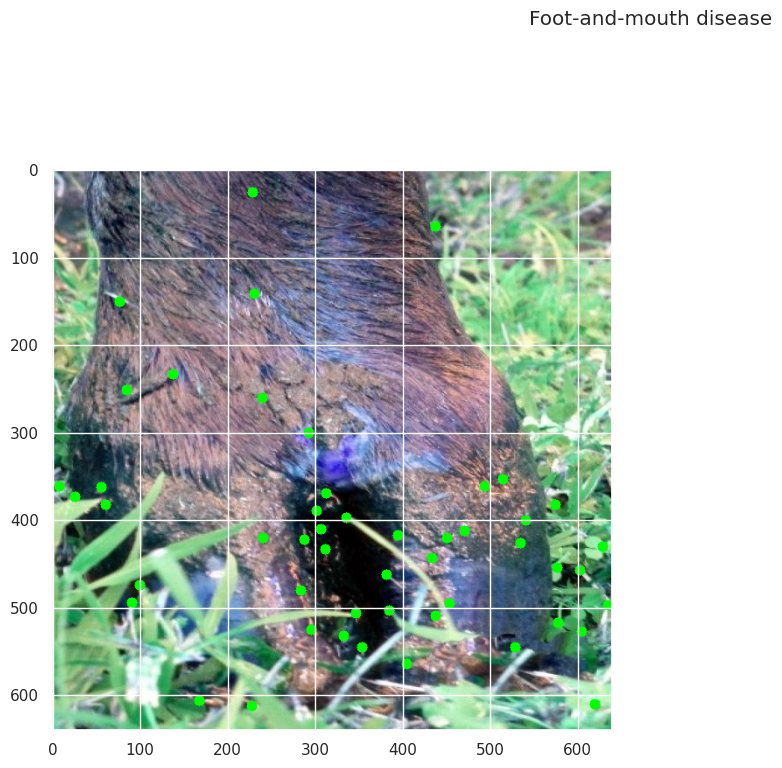

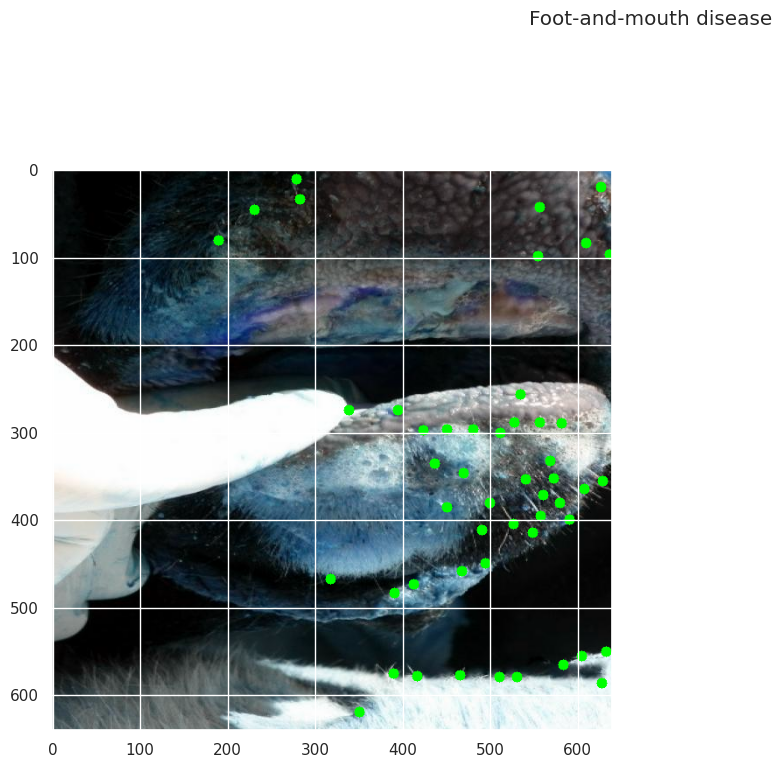

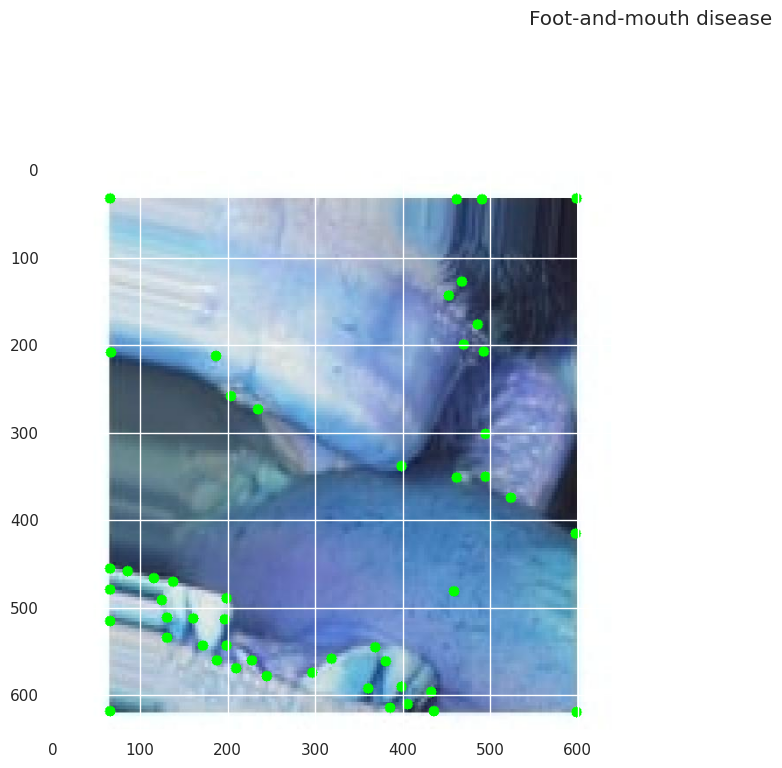

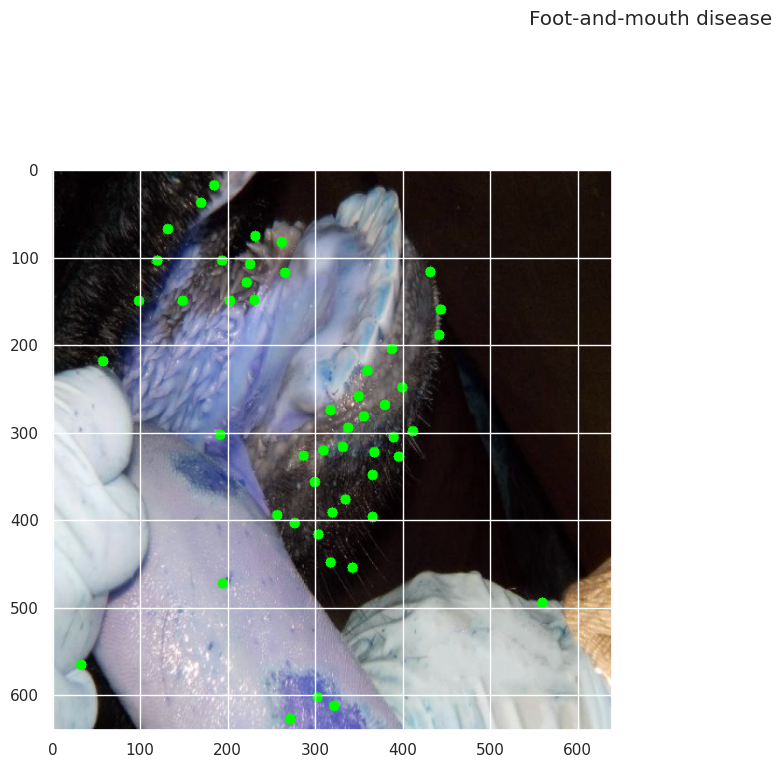

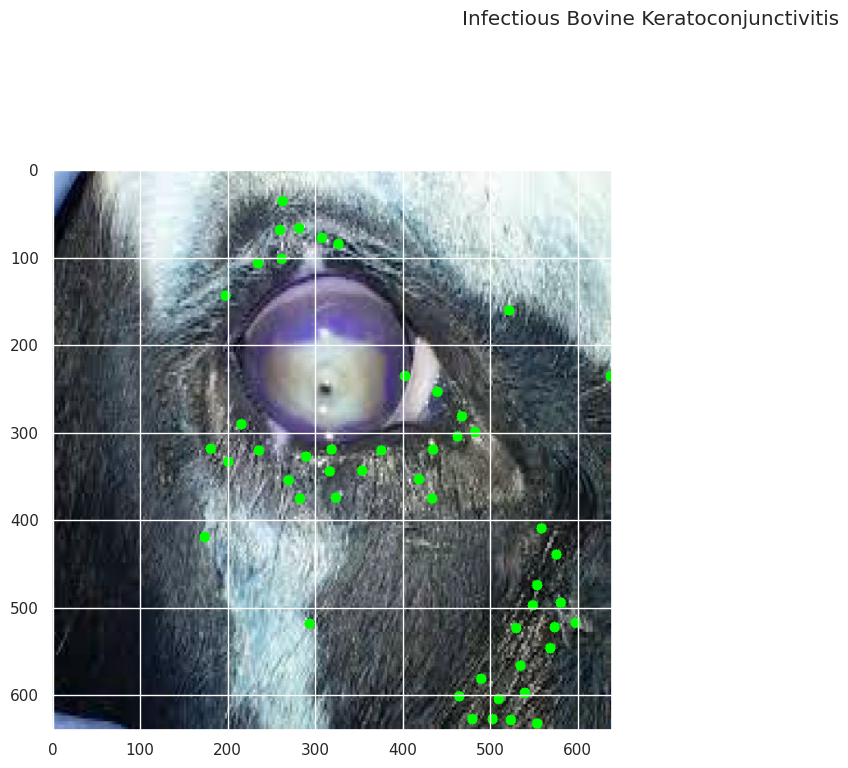

...

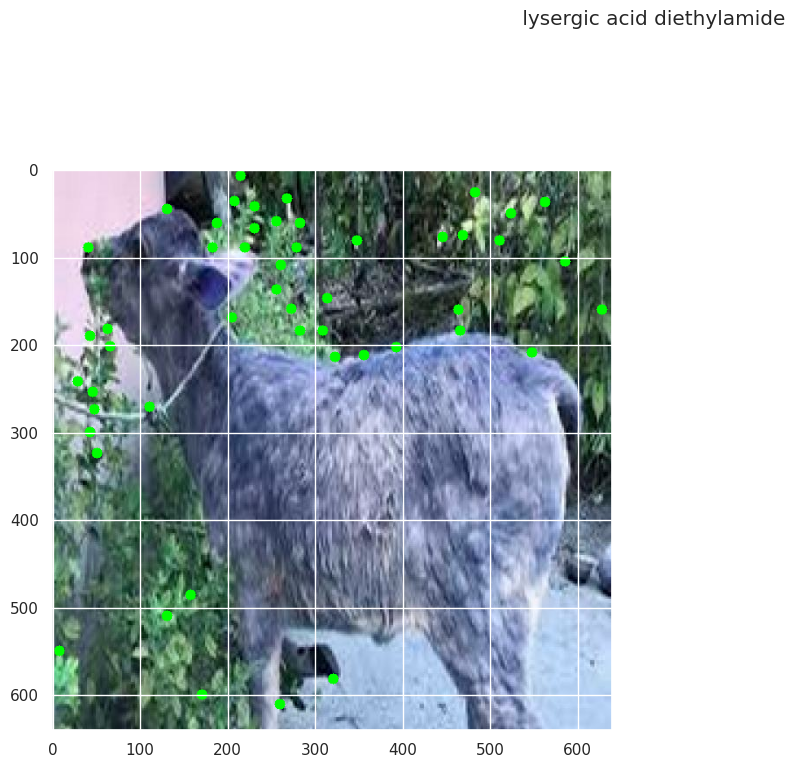

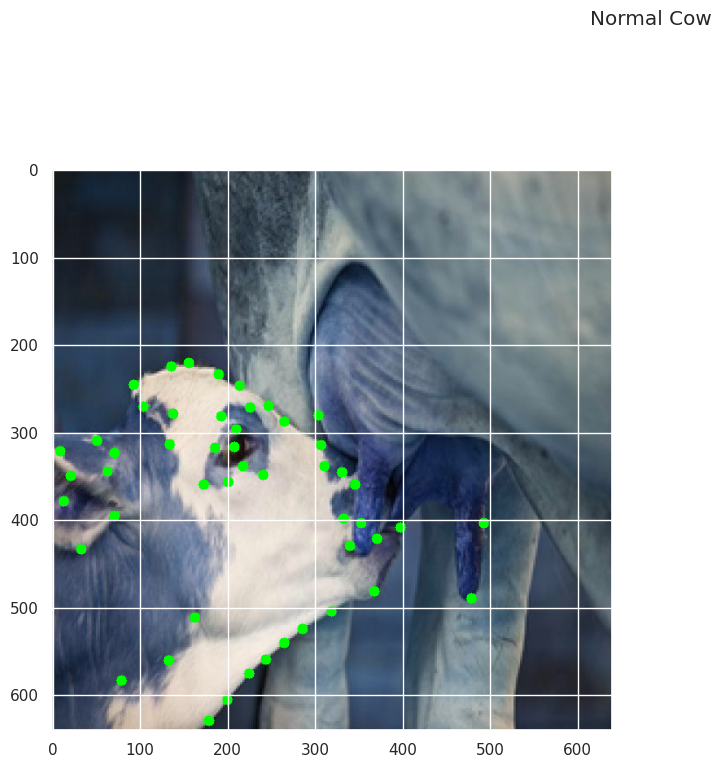

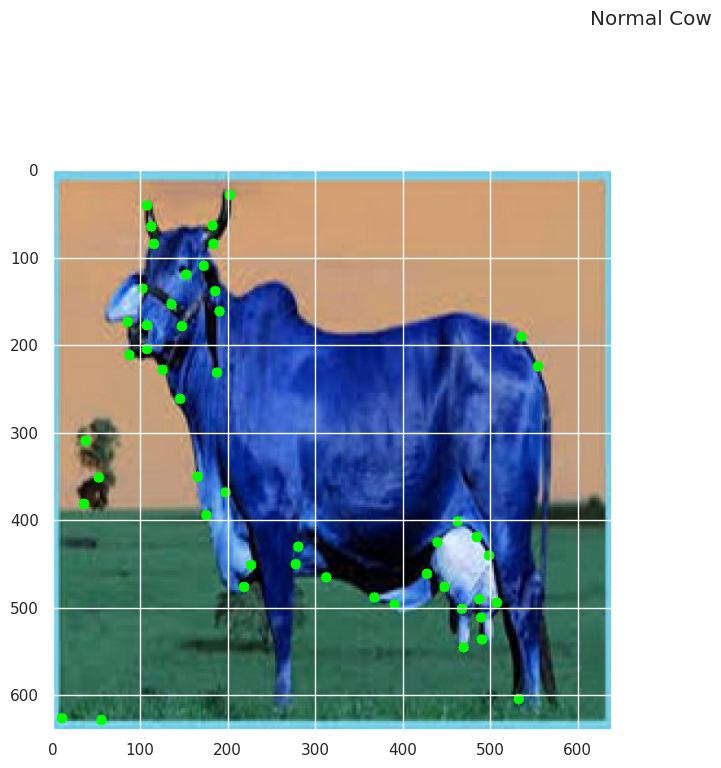

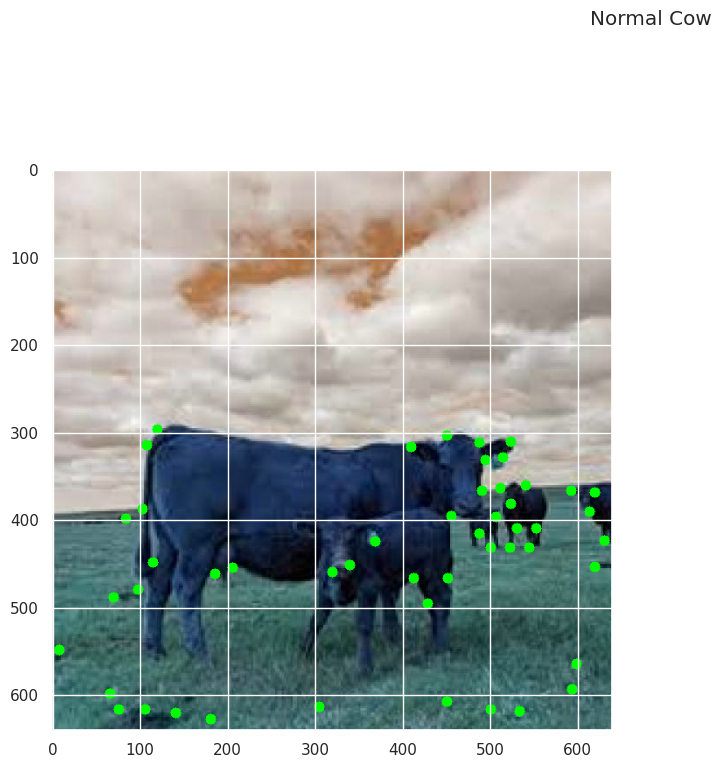

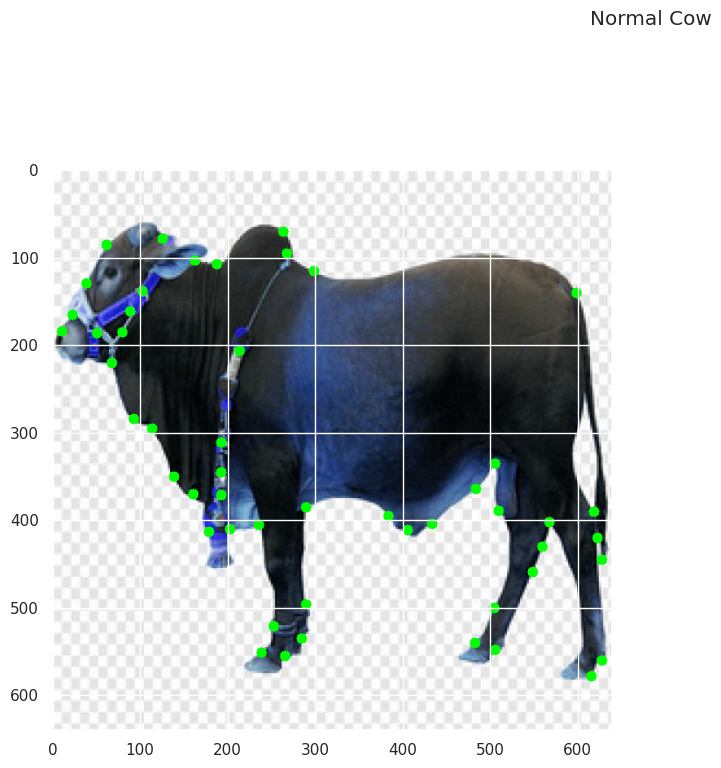

In [ ]:
for class_name in train_df['classname'].unique():
    corners_images_gray(class_name)

**Sift Features**

In [50]:
def sift_images_gray(class_name):
    classes_df = train_df[train_df['classname'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_df['path'],4)):
        image = cv2.imread(i)
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        sift = cv2.SIFT_create()
        kp, des = sift.detectAndCompute(gray, None)
        kp_img = cv2.drawKeypoints(image, kp, None, color=(0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        fig = plt.figure(figsize=(16, 16))
        plt.suptitle(classes[class_name])
        plt.subplot(2,2,1)
        plt.imshow(kp_img, cmap="viridis")
        plt.show()

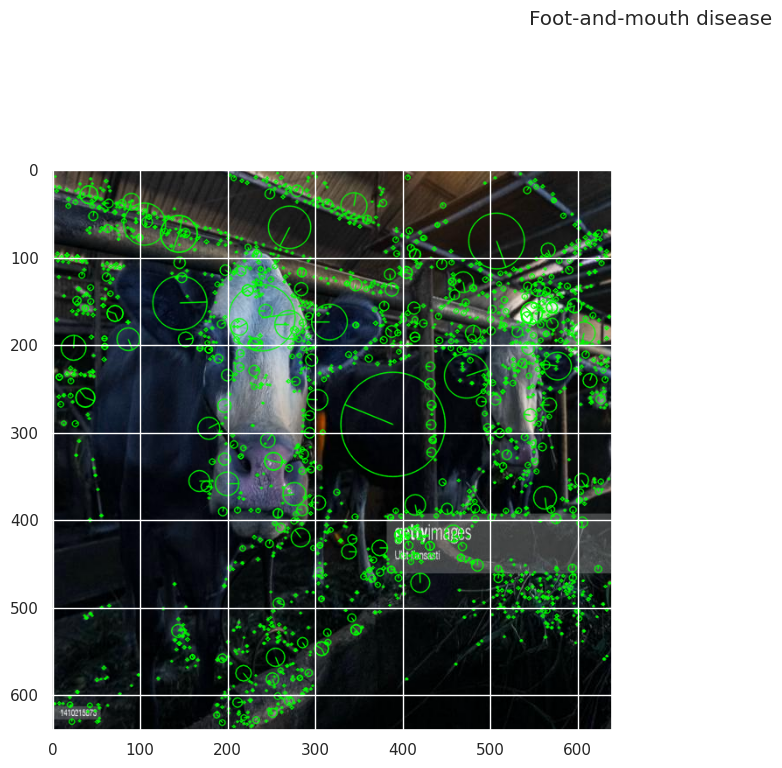

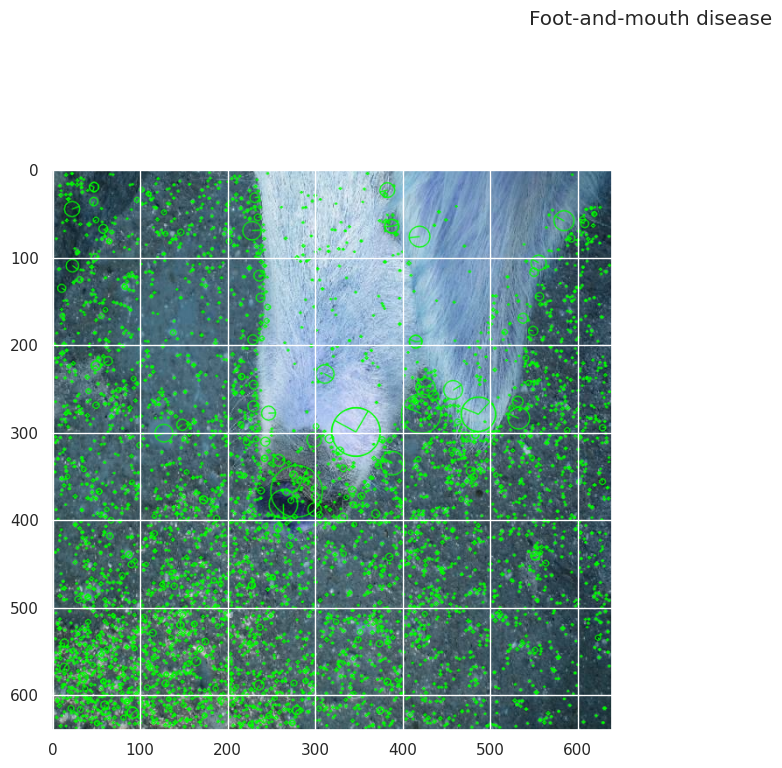

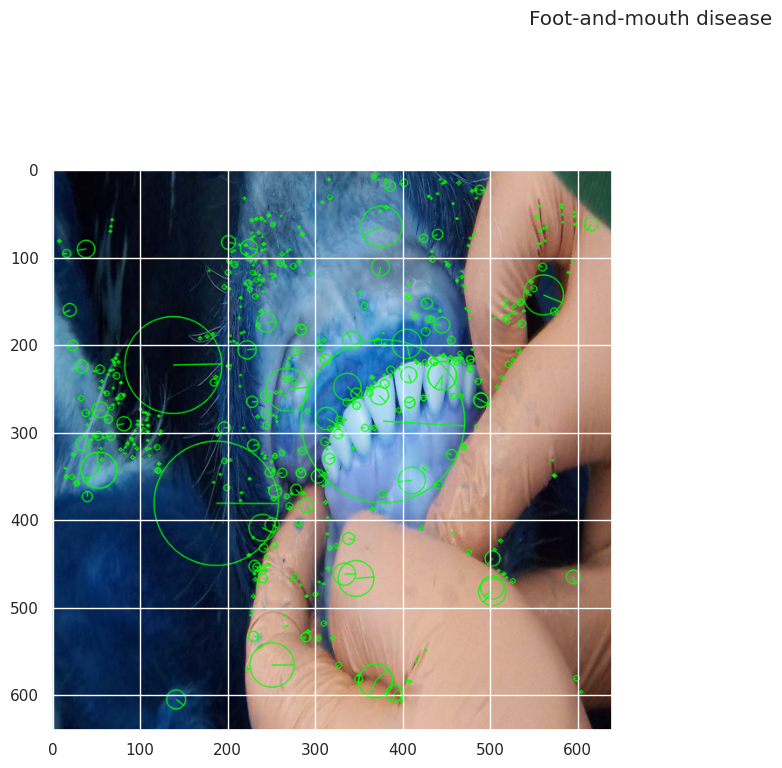

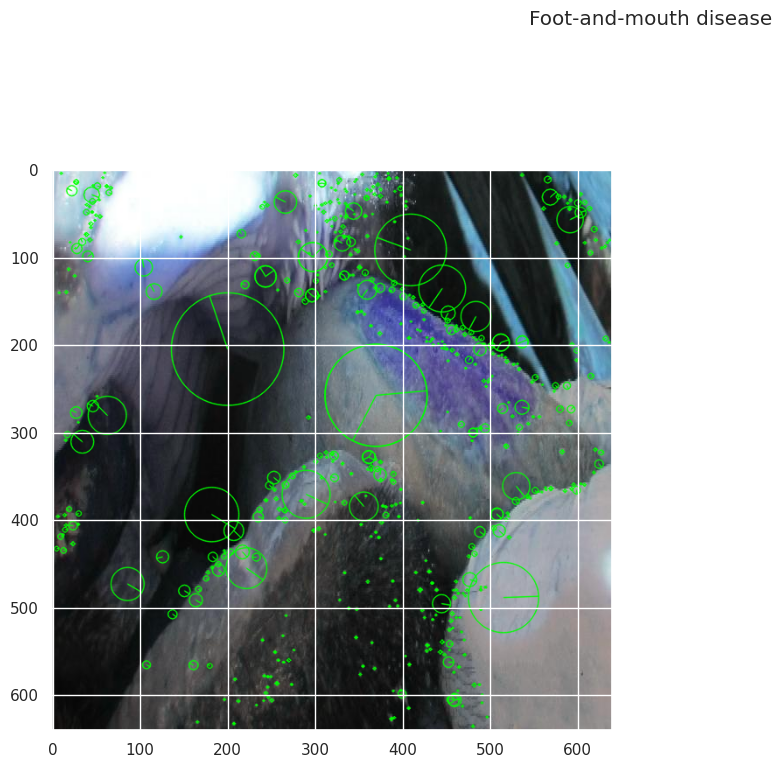

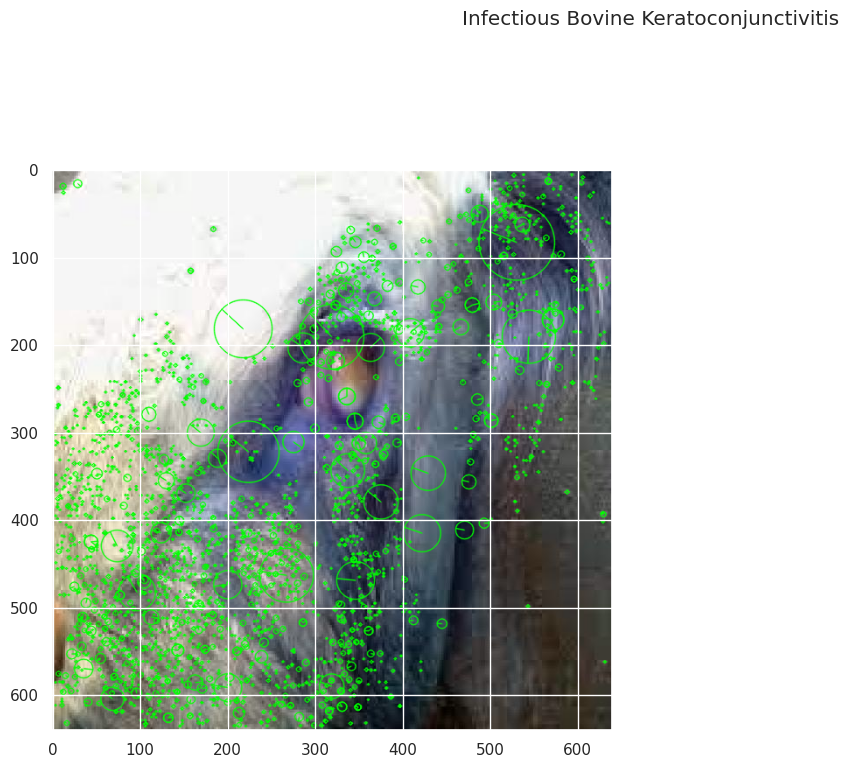

...

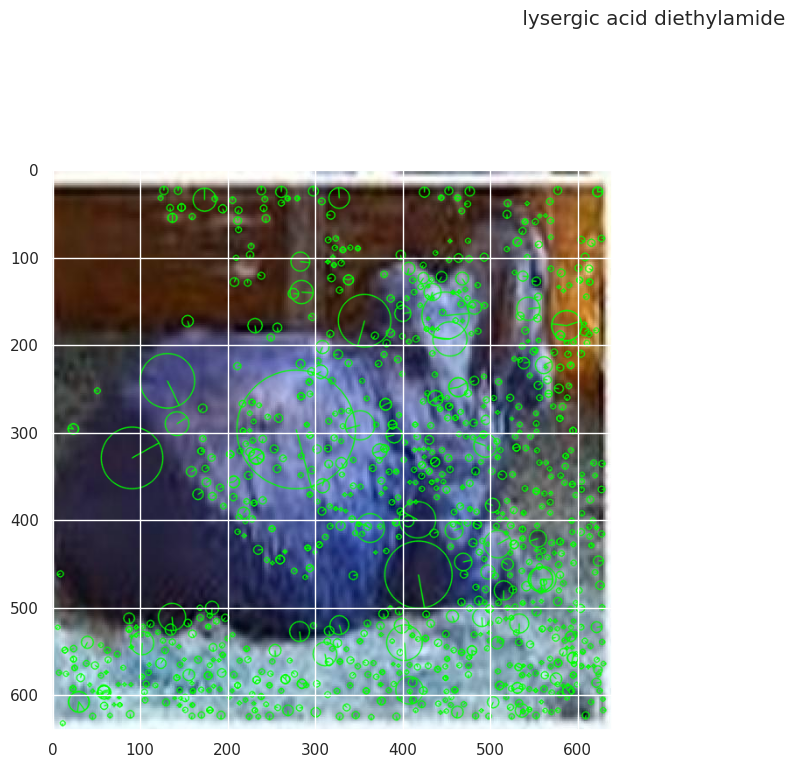

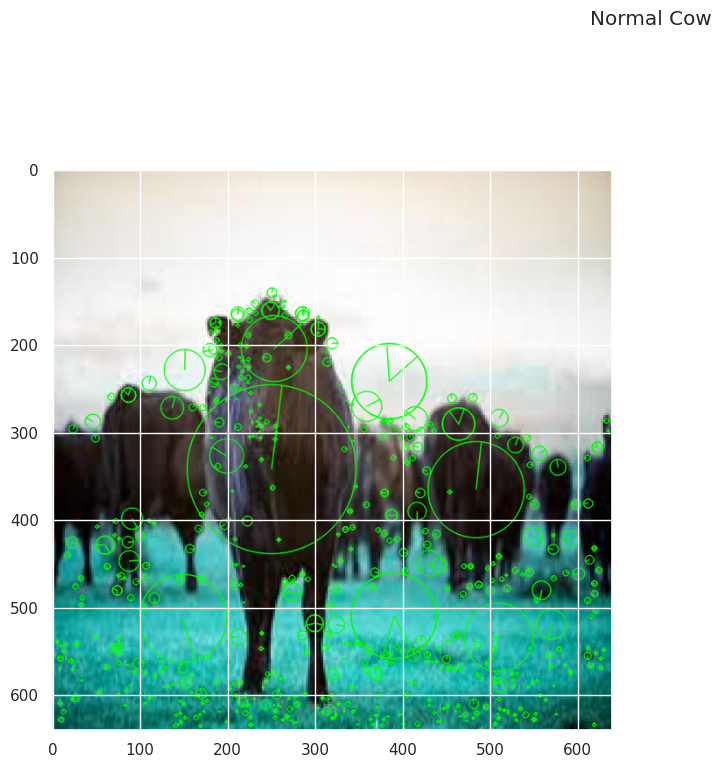

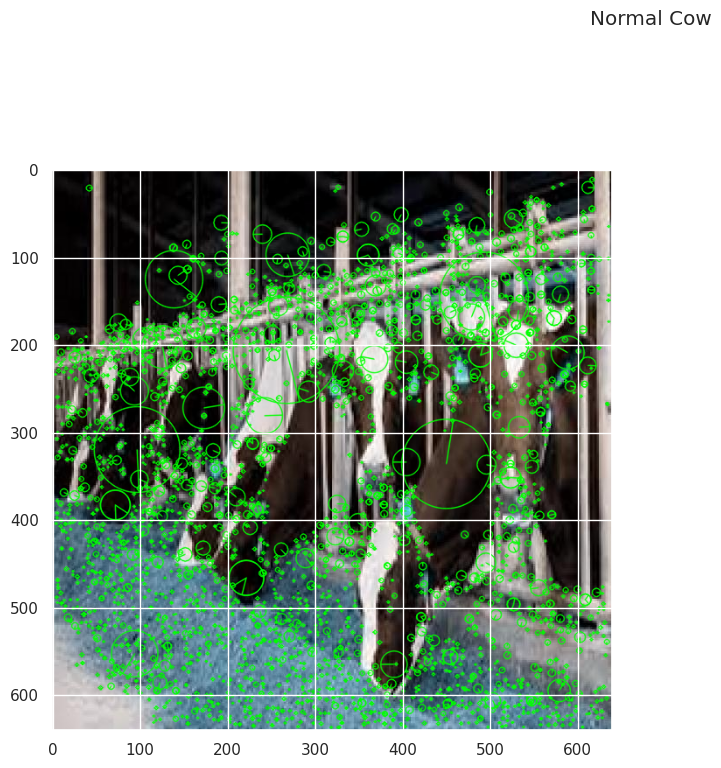

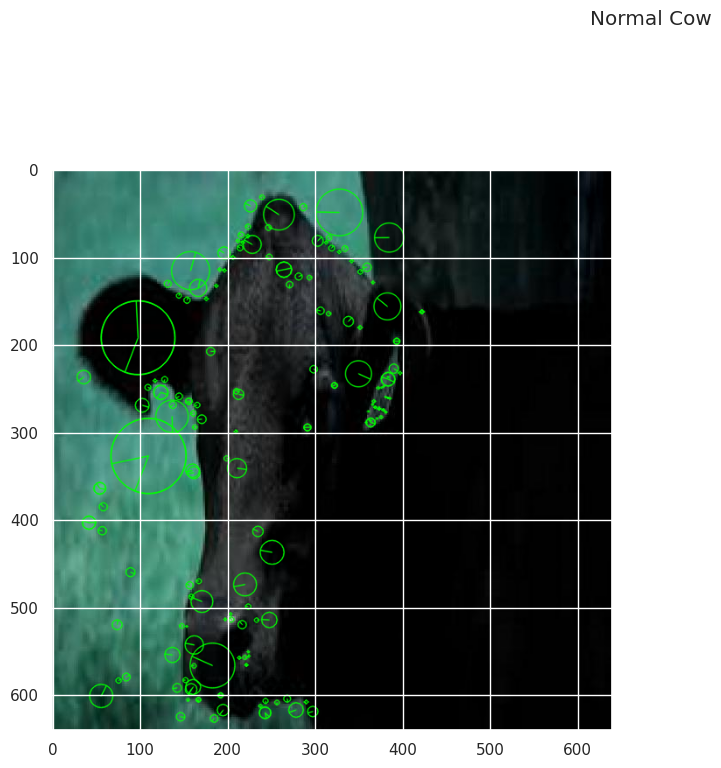

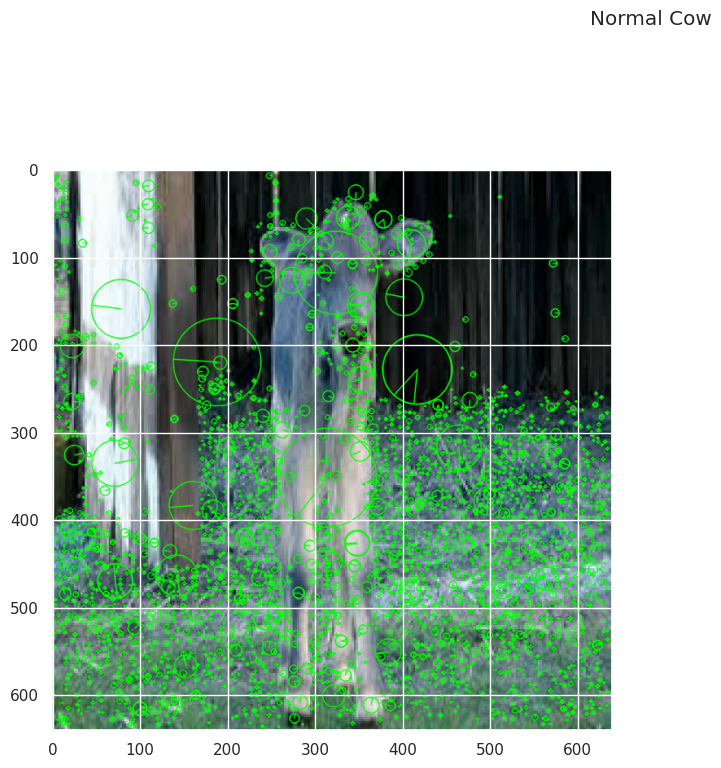

In [51]:
for class_name in train_df['classname'].unique():
    sift_images_gray(class_name)

**Plot Augmentations**

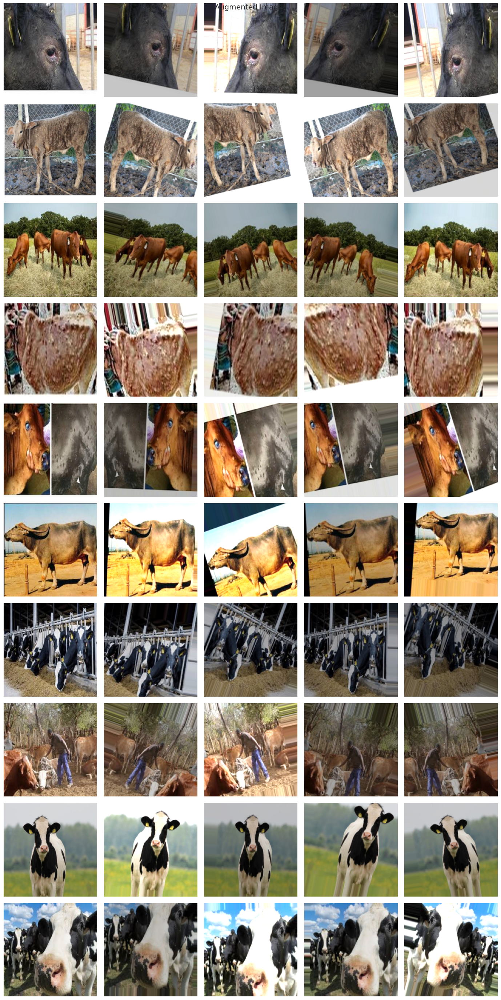

In [55]:
def plot_augimages(paths, datagen):
    plt.figure(figsize=(14, 28))
    plt.suptitle('Augmented Images')

    midx = 0
    for path in paths:
        data = Image.open(path)
        data = data.resize((224, 224))
        samples = expand_dims(np.array(data), 0)
        it = datagen.flow(samples, batch_size=1)

        # Show Original Image
        plt.subplot(10, 5, midx + 1)
        plt.imshow(data)
        plt.axis('off')

        # Show Augmented Images
        for idx in range(4):
            midx += 1
            plt.subplot(10, 5, midx + 1)

            batch = next(it)  # Use the built-in next() function
            image = batch[0].astype('uint8')
            plt.imshow(image)
            plt.axis('off')
        midx += 1

    plt.tight_layout()
    plt.show()


datagen = ImageDataGenerator(
    rotation_range=20,
    zoom_range=0.10,
    brightness_range=[0.6, 1.4],
    channel_shift_range=0.7,
    width_shift_range=0.15,
    height_shift_range=0.15,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Ensure that train_df['path'] is a list or array of image file paths
# Replace 'train_df' with the actual DataFrame or data structure you are using
# For example:
train_df = pd.DataFrame({'path': glob('/content/drive/MyDrive/cow _disease/train/*/*.jpg')})

plot_augimages(np.random.choice(train_df['path'], 10), datagen)

**Modelling**

In [66]:
y_count=len(train_df['classname'].unique())

In [57]:
print(train_df.columns)

Index(['path'], dtype='object')


**VGG16**

In [23]:
# re-size all the images to this
IMAGE_SIZE = [224, 224]

train_path = '/content/drive/MyDrive/cow _disease/train'
valid_path = '/content/drive/MyDrive/cow _disease/test'

In [24]:
# add preprocessing layer to the front of VGG
vgg = VGG16(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)



58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


In [25]:
# don't train existing weights
for layer in vgg.layers:
  layer.trainable = False

In [32]:
  # useful for getting number of classes
folders = glob('/content/drive/MyDrive/cow _disease/train/*')



In [33]:
# our layers - you can add more if you want
x = Flatten()(vgg.output)
# x = Dense(1000, activation='relu')(x)
prediction = Dense(len(folders), activation='softmax')(x)

In [34]:
# create a model object
model = Model(inputs=vgg.input, outputs=prediction)

In [35]:
# view the structure of the model
model.summary()


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 4)                   │         100,356 │
└──────────────────────────────────────┴─────────────────────────────┴──────────────

 Total params: 14,815,044 (56.51 MB)

 Trainable params: 100,356 (392.02 KB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [36]:
# tell the model what cost and optimization method to use
model.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)


In [43]:
# Re-size all the images to this size
IMAGE_SIZE = [224, 224]

train_path = '/content/drive/MyDrive/cow _disease/train'
valid_path = '/content/drive/MyDrive/cow _disease/test'

# Add preprocessing layer to the front of VGG
vgg = VGG16(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

# Don't train existing weights
for layer in vgg.layers:
    layer.trainable = False

# Useful for getting number of classes
folders = glob('/content/drive/MyDrive/cow _disease/train/*')

# Our layers - you can add more if you want
x = Flatten()(vgg.output)
# x = Dense(1000, activation='relu')(x)
prediction = Dense(len(folders), activation='softmax')(x)

# Create a model object
model = Model(inputs=vgg.input, outputs=prediction)

# View the structure of the model
model.summary()

# Tell the model what cost and optimization method to use
model.compile(
    loss='categorical_crossentropy',
    optimizer='adam',
    metrics=['accuracy']
)

train_datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
)

test_datagen = ImageDataGenerator(rescale=1./255)

training_set = train_datagen.flow_from_directory(
    train_path,
    target_size=IMAGE_SIZE,
    batch_size=32,
    class_mode='categorical'
)

test_set = test_datagen.flow_from_directory(
    valid_path,
    target_size=IMAGE_SIZE,
    batch_size=32,
    class_mode='categorical'
)

# Calculate steps
steps_per_epoch = training_set.n // training_set.batch_size
validation_steps = test_set.n // test_set.batch_size

# Fit the model
r = model.fit(
    training_set,
    validation_data=test_set,
    epochs=10,
    steps_per_epoch=steps_per_epoch,
    validation_steps=validation_steps
)


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 4)                   │         100,356 │
└──────────────────────────────────────┴─────────────────────────────┴──────────────

 Total params: 14,815,044 (56.51 MB)

 Trainable params: 100,356 (392.02 KB)

 Non-trainable params: 14,714,688 (56.13 MB)

Found 942 images belonging to 4 classes.
Found 135 images belonging to 4 classes.
Epoch 1/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 650s 22s/step - accuracy: 0.5340 - loss: 1.5946 - val_accuracy: 0.7656 - val_loss: 0.6892
Epoch 2/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 69s 2s/step - accuracy: 0.6562 - loss: 0.8131 - val_accuracy: 0.7143 - val_loss: 0.5434
Epoch 3/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 594s 20s/step - accuracy: 0.8407 - loss: 0.4420 - val_accuracy: 0.8281 - val_loss: 0.5521
Epoch 4/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 119ms/step - accuracy: 0.8750 - loss: 0.3151 - val_accuracy: 1.0000 - val_loss: 0.0481
Epoch 5/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 596s 20s/step - accuracy: 0.9092 - loss: 0.2986 - val_accuracy: 0.8594 - val_loss: 0.5382
Epoch 6/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 22s 126ms/step - accuracy: 0.8750 - loss: 0.3881 - val_accuracy: 0.8571 - val_loss: 0.2613
Epoch 7/10
29/29 ━━━━━━━━━━━━━━━━━━━━ 595s 20s/step - accuracy: 0.9411 - loss: 0.2047 - val_accuracy: 0.8359 - val_loss: 0.5755
Epoch 8/10
29/29 ━━━━━

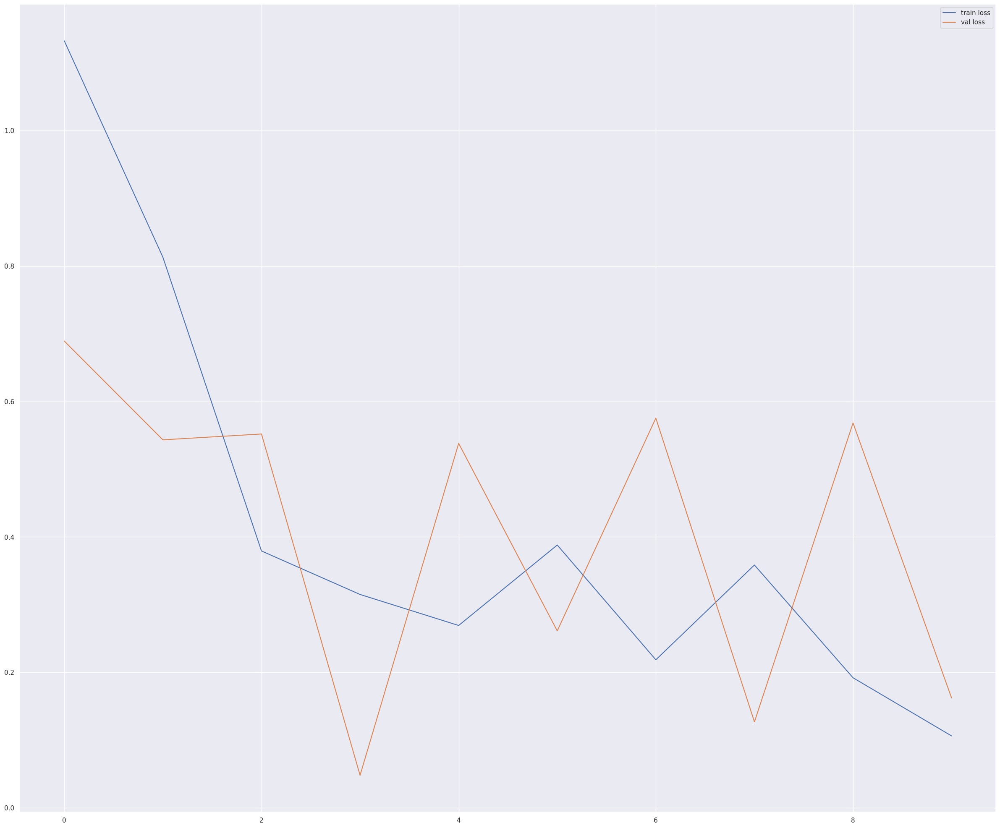

<Figure size 3000x2500 with 0 Axes>

In [44]:
# loss
plt.plot(r.history['loss'], label='train loss')
plt.plot(r.history['val_loss'], label='val loss')
plt.legend()
plt.show()
plt.savefig('LossVal_loss')


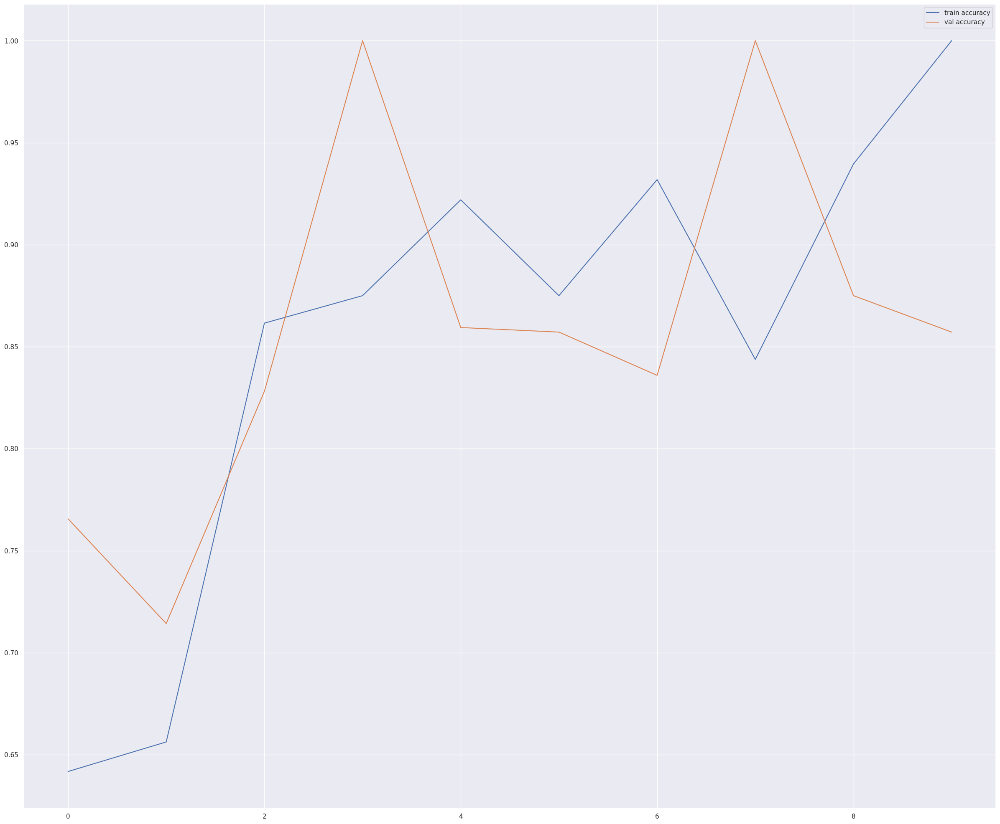

<Figure size 3000x2500 with 0 Axes>

In [48]:
# accuracies
plt.plot(r.history['accuracy'], label='train accuracy')
plt.plot(r.history['val_accuracy'], label='val accuracy')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

In [49]:
model.save('facefeatures_new_model.h5')